Other data sets that could be used in the future:

In [ ]:
# df_gas = pd.read_excel('/Users/Medy/Desktop/2020 FE Guide for DOE release dates before 3-10-2020-no-sales -3-9-2020public.xlsx')

In [ ]:
# df_smart_way = pd.read_excel('/Users/Medy/Desktop/SmartWay Vehicle List for MY 2020.xlsx')

In [4]:
pip install xlrd

     |████████████████████████████████| 103 kB 1.8 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [5]:
df_alpha = pd.read_excel('/Users/Medy/Desktop/Lab22/datasets_research/all_alpha_20.xlsx')

In [6]:
df_alpha.head()

,Model,Displ,Cyl,Trans,Drive,Fuel,Cert Region,Stnd,Stnd Description,Underhood ID,Veh Class,Air Pollution Score,City MPG,Hwy MPG,Cmb MPG,Greenhouse Gas Score,SmartWay,Comb CO2
0,ACURA ILX,2.4,4.0,AMS-8,2WD,Gasoline,CA,L3ULEV125,California LEV-III ULEV125,LHNXV02.4KH3,small car,3,24,34,28,6,No,316
1,ACURA ILX,2.4,4.0,AMS-8,2WD,Gasoline,FA,T3B125,Federal Tier 3 Bin 125,LHNXV02.4KH3,small car,3,24,34,28,6,No,316
2,ACURA MDX,3.0,6.0,AMS-7,4WD,Gasoline,CA,L3ULEV125,California LEV-III ULEV125,LHNXV03.0ABC,small SUV,3,26,27,27,6,No,333
3,ACURA MDX,3.0,6.0,AMS-7,4WD,Gasoline,FA,T3B125,Federal Tier 3 Bin 125,LHNXV03.0ABC,small SUV,3,26,27,27,6,No,333
4,ACURA MDX,3.5,6.0,SemiAuto-9,2WD,Gasoline,CA,L3ULEV125,California LEV-III ULEV125,LHNXV03.5PBM,small SUV,3,20,27,23,5,No,387


In [ ]:
# average_cost = pd.read_excel('/Users/Medy/Desktop/table_03_17_100219.xlsx')

In [ ]:
# kaggle = pd.read_csv('/Users/Medy/Desktop/Automobile_data.csv')

In [ ]:
# electric_wash = pd.read_csv('/Users/Medy/Desktop/Electric_Vehicle_Population_Data.csv')

Working on cleaning craiglist data set later named df1 in the nb and kaggle data later named df2!

In [2]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import category_encoders as ce
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import DecisionTreeRegressor
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomTreesEmbedding
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve
from sklearn.metrics import multilabel_confusion_matrix
from sklearn.linear_model import PassiveAggressiveClassifier
from sklearn.linear_model import RidgeClassifier
from sklearn.linear_model import PassiveAggressiveRegressor
# import xgboost as xgb
# from xgboost import XGBRegressor
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.preprocessing import StandardScaler
import plotly.express as px
import pickle

In [2]:
jayden = pd.read_csv('http://knuth.luther.edu/~osmaah02/cars.csv')

In [3]:
jayden.head()

,url,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,...,paint_color,image_url,lat,long,county_fips,county_name,state_fips,state_code,state_name,weather
0,https://marshall.craigslist.org/cto/d/2010-dod...,marshall,11900,2010.0,dodge,challenger se,good,6 cylinders,gas,43600.0,...,red,https://images.craigslist.org/00i0i_2ggH1eKDNK...,43.4775,-96.7041,46083.0,Lincoln,46.0,SD,South Dakota,38.0
1,https://marshall.craigslist.org/cto/d/fleetwoo...,marshall,1515,1999.0,NaN,fleetwood,NaN,NaN,gas,NaN,...,NaN,https://images.craigslist.org/00M0M_irjh7SjEcU...,44.7612,-96.6907,46039.0,Deuel,46.0,SD,South Dakota,38.0
2,https://marshall.craigslist.org/cto/d/2008-for...,marshall,17550,2008.0,ford,f-150,NaN,NaN,gas,NaN,...,NaN,https://images.craigslist.org/00s0s_eL2XFhEUcx...,44.1415,-103.2052,46093.0,Meade,46.0,SD,South Dakota,38.0
3,https://marshall.craigslist.org/cto/d/ford-tau...,marshall,2800,2004.0,ford,taurus,good,6 cylinders,gas,168591.0,...,grey,https://images.craigslist.org/00L0L_5HUR1nQjt8...,43.2845,-95.5930,19143.0,Osceola,19.0,IA,Iowa,47.0
4,https://marshall.craigslist.org/cto/d/2001-gra...,marshall,400,2001.0,NaN,2001 Grand Prix,NaN,NaN,gas,217000.0,...,NaN,https://images.craigslist.org/00n0n_bJJ1XnonSG...,43.0261,-94.4064,19109.0,Kossuth,19.0,IA,Iowa,47.0


In [4]:
jayden.shape

(1723065, 26)

In [5]:
jayden['image_url'][0]
# Looks like url for images isnt availble, initial thought was usage for comuter vision

'https://images.craigslist.org/00i0i_2ggH1eKDNKZ_600x450.jpg'

Data Analysis and cleaning!

In [6]:
jayden.describe().T

,count,mean,std,min,25%,50%,75%,max
price,1723065.0,107554.037916,1.004439e+07,1.000000,3295.000,7000.00000,14999.000000,2.068627e+09
year,1716750.0,2004.840841,1.208772e+01,302.000000,2002.000,2007.00000,2012.000000,2.019000e+03
odometer,1159011.0,113638.652723,1.368603e+05,0.000000,58000.000,107000.00000,152000.000000,1.000000e+07
lat,1723065.0,38.781951,5.976412e+00,-84.810047,34.919,39.40989,42.554592,9.000000e+01
long,1723065.0,-93.711980,1.696519e+01,-999.999999,-105.801,-88.24070,-81.026500,1.397061e+02
county_fips,1664232.0,28430.533792,1.605423e+04,1001.000000,12123.000,29021.00000,41067.000000,5.604500e+04
state_fips,1664232.0,28.344100,1.603224e+01,1.000000,12.000,29.00000,41.000000,5.600000e+01
weather,1663637.0,53.787060,7.799381e+00,29.000000,48.000,53.00000,59.000000,7.900000e+01


In [7]:
jayden.isnull().sum()

url                   0
city                  0
price                 0
year               6315
manufacturer     136414
make              69699
condition        700790
cylinders        691291
fuel              10367
odometer         564054
title_status       2554
transmission       9022
vin             1118215
drive            661884
size            1123967
type             702931
paint_color      695650
image_url             1
lat                   0
long                  0
county_fips       58833
county_name       58833
state_fips        58833
state_code        58833
state_name            0
weather           59428
dtype: int64

In [8]:
jayden['vin'].isnull().sum()

1118215

In [9]:
df1 = jayden.dropna(axis=0)

In [10]:
df1.shape

(142330, 26)

In [11]:
df1.describe(include='all')

,url,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,...,paint_color,image_url,lat,long,county_fips,county_name,state_fips,state_code,state_name,weather
count,142330,142330,1.423300e+05,142330.000000,142330,142330,142330,142330,142330,1.423300e+05,...,142330,142330,142330.000000,142330.000000,142330.000000,142330,142330.000000,142330,142330,142330.000000
unique,142330,437,NaN,NaN,49,13318,6,8,5,NaN,...,12,97502,NaN,NaN,NaN,1518,NaN,50,50,NaN
top,https://milwaukee.craigslist.org/ctd/d/2009-gm...,greenbay,NaN,NaN,ford,f-150,excellent,6 cylinders,gas,NaN,...,white,https://images.craigslist.org/00p0p_gzd4BO7sXk...,NaN,NaN,NaN,Orange,NaN,FL,Florida,NaN
freq,1,1905,NaN,NaN,28075,3230,72642,50650,131639,NaN,...,31274,49,NaN,NaN,NaN,3390,NaN,10866,10866,NaN
mean,NaN,NaN,4.657052e+04,2007.491084,NaN,NaN,NaN,NaN,NaN,1.152199e+05,...,NaN,NaN,38.891283,-91.520037,28689.173294,NaN,28.602789,NaN,NaN,52.985702
std,NaN,NaN,5.945527e+06,8.862633,NaN,NaN,NaN,NaN,NaN,1.411693e+05,...,NaN,NaN,5.436415,15.393594,15739.764525,NaN,15.719279,NaN,NaN,7.832213
min,NaN,NaN,1.000000e+00,1900.000000,NaN,NaN,NaN,NaN,NaN,0.000000e+00,...,NaN,NaN,20.071733,-156.503600,1001.000000,NaN,1.000000,NaN,NaN,29.000000
25%,NaN,NaN,4.975000e+03,2005.000000,NaN,NaN,NaN,NaN,NaN,6.600000e+04,...,NaN,NaN,35.190556,-97.044974,13297.000000,NaN,13.000000,NaN,NaN,47.000000
50%,NaN,NaN,9.300000e+03,2009.000000,NaN,NaN,NaN,NaN,NaN,1.088810e+05,...,NaN,NaN,39.829891,-87.279300,28137.000000,NaN,28.000000,NaN,NaN,52.000000
75%,NaN,NaN,1.680000e+04,2013.000000,NaN,NaN,NaN,NaN,NaN,1.500000e+05,...,NaN,NaN,42.724460,-80.728080,41019.000000,NaN,41.000000,NaN,NaN,59.000000


In [12]:
df1['price'].isnull().sum()

0

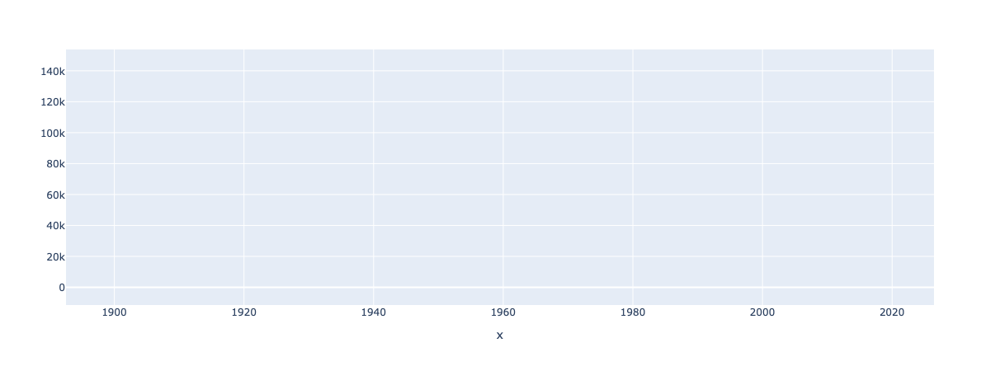

In [13]:
fig = px.scatter(df1['price'], df1['year'])
fig.show()

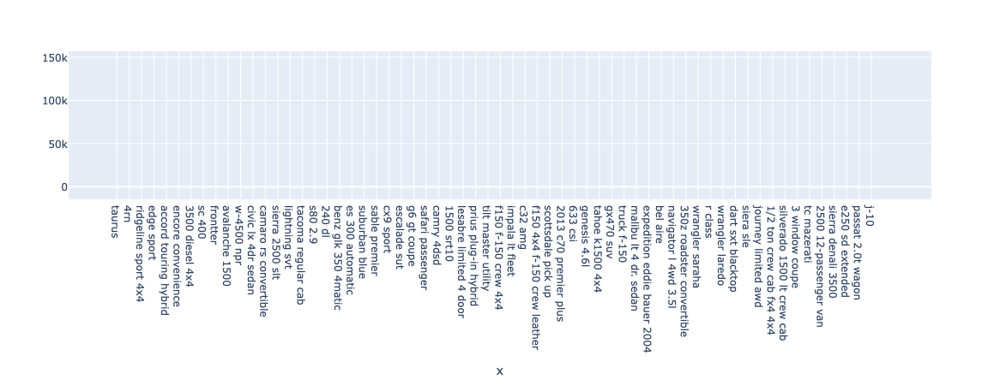

In [14]:
fig = px.scatter(df1['price'], df1['make'])
fig.show()

In [15]:
# columns = ['model', 'year' 'make', 'price' '5 years price projection', 'typeofenergy', 'co2 emisson', '0to60 acceleration', 'cargo', 'safetyrating', 'range', 'selfdriving', 'recalls', 'depreciation', 'maintenance',]
# base_line = pd.DataFrame(columns=columns)
# base_line.shape
# kaggle = pd.read_csv('/Users/Medy/Desktop/vehicles.csv')
# kaggle.shape
# kaggle.head()
# kaggle.isnull().sum()
# df2 = kaggle.dropna(axis=0)
# df2.shape
# df1.head()

Dropping unecessary features and matchign kaggle dataset!

In [16]:
df1 = df1.drop(['url', 'image_url', 'county_fips', 'county_name', 'state_fips', 'state_name', 'weather'], axis=1)

In [17]:
df1 

,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,vin,drive,size,type,paint_color,lat,long,state_code
3,marshall,2800,2004.0,ford,taurus,good,6 cylinders,gas,168591.0,clean,automatic,1FAFP55UO4G113464,fwd,full-size,sedan,grey,43.284500,-95.593000,IA
140,reading,4480,2010.0,honda,insight,good,4 cylinders,hybrid,110000.0,clean,automatic,JHMZE2H76AS003740,fwd,mid-size,hatchback,silver,40.346600,-75.935100,PA
157,chambersburg,4500,2005.0,chevy,2500 hd,good,8 cylinders,gas,204000.0,clean,automatic,Xxxxxxxxxx,rwd,full-size,truck,grey,39.988573,-77.801924,PA
203,rapidcity,38500,2017.0,chevrolet,silverado,like new,8 cylinders,gas,44710.0,clean,automatic,3GCUKREC8HG363009,4wd,full-size,offroad,red,43.818800,-103.206000,SD
243,salina,800,2001.0,ford,escort zx2,fair,4 cylinders,gas,93400.0,clean,automatic,3FAFP11371R241940,fwd,compact,coupe,brown,38.838925,-97.585546,KS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1722720,saltlakecity,3500,2002.0,toyota,camry xle,good,6 cylinders,gas,200000.0,clean,automatic,4T1BF30K52U015675,fwd,mid-size,sedan,silver,41.189400,-111.948900,UT
1723016,akroncanton,22900,2012.0,dodge,grand caravan,excellent,6 cylinders,gas,42680.0,clean,automatic,2C4RDGCG2CR111897,fwd,mid-size,van,black,42.635079,-83.665878,MI
1723029,westky,8350,2008.0,cadillac,dts,excellent,8 cylinders,gas,75325.0,clean,automatic,1G6KD57Y58U195302,fwd,full-size,sedan,black,37.963700,-87.393800,IN
1723063,marshall,4788,2009.0,toyota,camry,good,4 cylinders,gas,210682.0,clean,automatic,4T1BE46K09U401902,fwd,mid-size,sedan,red,43.388900,-95.136900,IA


In [18]:
df1.dtypes

city             object
price             int64
year            float64
manufacturer     object
make             object
condition        object
cylinders        object
fuel             object
odometer        float64
title_status     object
transmission     object
vin              object
drive            object
size             object
type             object
paint_color      object
lat             float64
long            float64
state_code       object
dtype: object

In [19]:
# resetting index and turing year and odometer to integers!
df1 = df1.reset_index()

In [20]:
df1.head()

,index,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,vin,drive,size,type,paint_color,lat,long,state_code
0,3,marshall,2800,2004.0,ford,taurus,good,6 cylinders,gas,168591.0,clean,automatic,1FAFP55UO4G113464,fwd,full-size,sedan,grey,43.284500,-95.593000,IA
1,140,reading,4480,2010.0,honda,insight,good,4 cylinders,hybrid,110000.0,clean,automatic,JHMZE2H76AS003740,fwd,mid-size,hatchback,silver,40.346600,-75.935100,PA
2,157,chambersburg,4500,2005.0,chevy,2500 hd,good,8 cylinders,gas,204000.0,clean,automatic,Xxxxxxxxxx,rwd,full-size,truck,grey,39.988573,-77.801924,PA
3,203,rapidcity,38500,2017.0,chevrolet,silverado,like new,8 cylinders,gas,44710.0,clean,automatic,3GCUKREC8HG363009,4wd,full-size,offroad,red,43.818800,-103.206000,SD
4,243,salina,800,2001.0,ford,escort zx2,fair,4 cylinders,gas,93400.0,clean,automatic,3FAFP11371R241940,fwd,compact,coupe,brown,38.838925,-97.585546,KS


In [21]:
df1 = df1.drop(['index'], axis=1)

In [22]:
df1['year'] = df1['year'].apply(np.int64)

In [23]:
df1['odometer'] = df1['odometer'].apply(np.int64)

In [24]:
df1.head()

,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,vin,drive,size,type,paint_color,lat,long,state_code
0,marshall,2800,2004,ford,taurus,good,6 cylinders,gas,168591,clean,automatic,1FAFP55UO4G113464,fwd,full-size,sedan,grey,43.284500,-95.593000,IA
1,reading,4480,2010,honda,insight,good,4 cylinders,hybrid,110000,clean,automatic,JHMZE2H76AS003740,fwd,mid-size,hatchback,silver,40.346600,-75.935100,PA
2,chambersburg,4500,2005,chevy,2500 hd,good,8 cylinders,gas,204000,clean,automatic,Xxxxxxxxxx,rwd,full-size,truck,grey,39.988573,-77.801924,PA
3,rapidcity,38500,2017,chevrolet,silverado,like new,8 cylinders,gas,44710,clean,automatic,3GCUKREC8HG363009,4wd,full-size,offroad,red,43.818800,-103.206000,SD
4,salina,800,2001,ford,escort zx2,fair,4 cylinders,gas,93400,clean,automatic,3FAFP11371R241940,fwd,compact,coupe,brown,38.838925,-97.585546,KS


In [25]:
# df1.describe().T

In [26]:
df1.describe(include='all')

,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,vin,drive,size,type,paint_color,lat,long,state_code
count,142330,1.423300e+05,142330.000000,142330,142330,142330,142330,142330,1.423300e+05,142330,142330,142330,142330,142330,142330,142330,142330.000000,142330.000000,142330
unique,437,NaN,NaN,49,13318,6,8,5,NaN,6,3,86444,3,4,13,12,NaN,NaN,50
top,greenbay,NaN,NaN,ford,f-150,excellent,6 cylinders,gas,NaN,clean,automatic,0,4wd,full-size,SUV,white,NaN,NaN,FL
freq,1905,NaN,NaN,28075,3230,72642,50650,131639,NaN,135518,128759,785,63494,78127,38891,31274,NaN,NaN,10866
mean,NaN,4.657052e+04,2007.491084,NaN,NaN,NaN,NaN,NaN,1.152199e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,38.891283,-91.520037,NaN
std,NaN,5.945527e+06,8.862633,NaN,NaN,NaN,NaN,NaN,1.411693e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.436415,15.393594,NaN
min,NaN,1.000000e+00,1900.000000,NaN,NaN,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.071733,-156.503600,NaN
25%,NaN,4.975000e+03,2005.000000,NaN,NaN,NaN,NaN,NaN,6.600000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35.190556,-97.044974,NaN
50%,NaN,9.300000e+03,2009.000000,NaN,NaN,NaN,NaN,NaN,1.088810e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,39.829891,-87.279300,NaN
75%,NaN,1.680000e+04,2013.000000,NaN,NaN,NaN,NaN,NaN,1.500000e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,42.724460,-80.728080,NaN


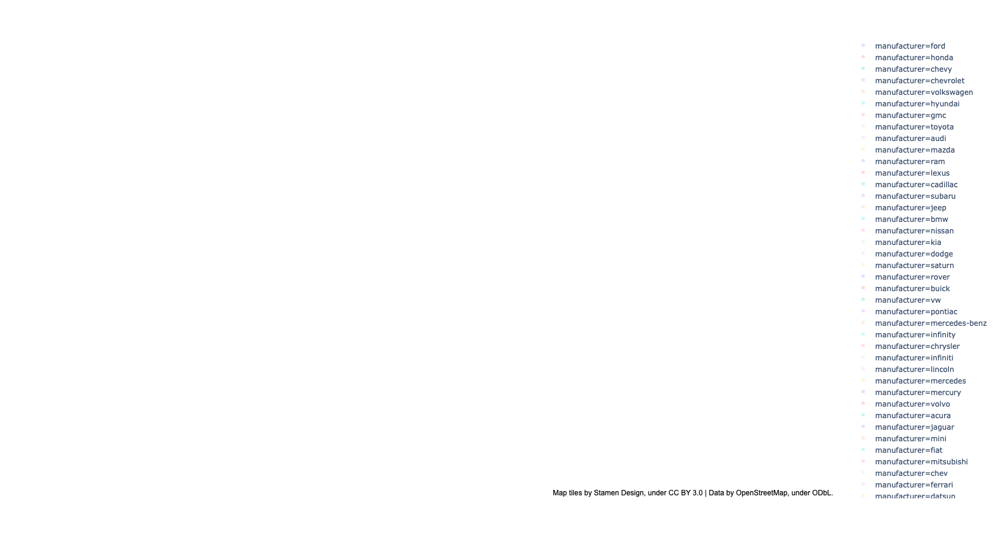

In [27]:
# https://plot.ly/python/mapbox-layers/#base-maps-in-layoutmapboxstyle
fig = px.scatter_mapbox(df1, lat='lat', lon='long', color='manufacturer', opacity=0.1)
fig.update_layout(mapbox_style='stamen-terrain')
fig.show()

In [28]:
make = df1['make'].unique()
make[:50]

array(['taurus', 'insight', '2500 hd', 'silverado', 'escort zx2',
       'blazer 4x4', 'jetta', 'equinox ltz', 'sonata', '1500 yukon',
       'malibu lt', '1500 silverado', 'avalon xls', '4runner',
       'special deluxe', 's4', '6i grand touring', '5500', 'ranger',
       'gs 300', 'corvette', 'f100', 's2000', 'silverado 1500', 'f350',
       'deville base 4dr sedan', 'escape', 'f-250 super duty', 'forester',
       'f150', 'f-350 sd', 'escalade', 'silverado 3500',
       'commander limited', 'accord ex-l v6', 'x5', 'passat 1.8t',
       'sentra 2.0 s', '1500 sierra', 'altima 2.5 s', 'sedona ex',
       'civic', 'rav4', 'wrangler', 'ls', 'mustang gt premium',
       'fusion se', 'passat', 'odyssey touring', 'grand caravan'],
      dtype=object)

In [29]:
manufacturer = df1['manufacturer'].unique()
manufacturer

array(['ford', 'honda', 'chevy', 'chevrolet', 'volkswagen', 'hyundai',
       'gmc', 'toyota', 'audi', 'mazda', 'ram', 'lexus', 'cadillac',
       'subaru', 'jeep', 'bmw', 'nissan', 'kia', 'dodge', 'saturn',
       'rover', 'buick', 'vw', 'pontiac', 'mercedes-benz', 'infinity',
       'chrysler', 'infiniti', 'lincoln', 'mercedes', 'mercury', 'volvo',
       'acura', 'jaguar', 'mini', 'fiat', 'mitsubishi', 'chev', 'ferrari',
       'datsun', 'porche', 'aston-martin', 'alfa-romeo', 'alfa',
       'harley-davidson', 'harley', 'aston', 'land rover', 'landrover'],
      dtype=object)

In [30]:
city = df1['city'].unique()
city[:10]

array(['marshall', 'reading', 'chambersburg', 'rapidcity', 'salina', 'nd',
       'lascruces', 'csd', 'mattoon', 'charlotte'], dtype=object)

In [31]:
state_code = df1['state_code'].unique()
state_code

array(['IA', 'PA', 'SD', 'KS', 'ND', 'MT', 'NM', 'IL', 'NC', 'SC', 'MA',
       'WA', 'ID', 'NY', 'TX', 'VA', 'WV', 'WI', 'MO', 'FL', 'CO', 'RI',
       'MS', 'MI', 'IN', 'CT', 'OR', 'TN', 'OH', 'GA', 'MN', 'NV', 'NH',
       'CA', 'AK', 'NJ', 'WY', 'VT', 'AR', 'DE', 'AZ', 'UT', 'NE', 'KY',
       'MD', 'ME', 'OK', 'LA', 'AL', 'HI'], dtype=object)

In [32]:
# when trying to merge craiglist and kaggle data sets, make in cl data is the model in kaggle~!
# df1 = df1.drop(['make'], axis=1)

In [33]:
df1.describe(include='all')

,city,price,year,manufacturer,make,condition,cylinders,fuel,odometer,title_status,transmission,vin,drive,size,type,paint_color,lat,long,state_code
count,142330,1.423300e+05,142330.000000,142330,142330,142330,142330,142330,1.423300e+05,142330,142330,142330,142330,142330,142330,142330,142330.000000,142330.000000,142330
unique,437,NaN,NaN,49,13318,6,8,5,NaN,6,3,86444,3,4,13,12,NaN,NaN,50
top,greenbay,NaN,NaN,ford,f-150,excellent,6 cylinders,gas,NaN,clean,automatic,0,4wd,full-size,SUV,white,NaN,NaN,FL
freq,1905,NaN,NaN,28075,3230,72642,50650,131639,NaN,135518,128759,785,63494,78127,38891,31274,NaN,NaN,10866
mean,NaN,4.657052e+04,2007.491084,NaN,NaN,NaN,NaN,NaN,1.152199e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,38.891283,-91.520037,NaN
std,NaN,5.945527e+06,8.862633,NaN,NaN,NaN,NaN,NaN,1.411693e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.436415,15.393594,NaN
min,NaN,1.000000e+00,1900.000000,NaN,NaN,NaN,NaN,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.071733,-156.503600,NaN
25%,NaN,4.975000e+03,2005.000000,NaN,NaN,NaN,NaN,NaN,6.600000e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35.190556,-97.044974,NaN
50%,NaN,9.300000e+03,2009.000000,NaN,NaN,NaN,NaN,NaN,1.088810e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,39.829891,-87.279300,NaN
75%,NaN,1.680000e+04,2013.000000,NaN,NaN,NaN,NaN,NaN,1.500000e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,42.724460,-80.728080,NaN


Running 3 models on craiglist dataset alone for a baseline!
Logisitc Regression
Gradient Boosting
Random Forset Regressor

In [34]:
# Splitting data into train,val,test
train, val = train_test_split(df1, train_size=0.70, test_size=0.30)
train, test = train_test_split(train, train_size= 0.80, test_size=0.20) 

In [35]:
train.shape, val.shape, test.shape

((79704, 19), (42699, 19), (19927, 19))

In [36]:
# setting features matrix and target vector!
target = 'price'
features = train.columns.drop([target])
X_train = train[features]
y_train = train[target]
X_val = val[features]
y_val = val[target]
X_test = test[features]
y_test = test[target]

In [37]:
%%time

pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='mean'), 
    GradientBoostingRegressor()
)

# Fit on train, score on val

pipeline.fit(X_train, y_train)
print('Train Accuracy', pipeline.score(X_train, y_train))
print('Validation Accuracy', pipeline.score(X_val, y_val))

Train Accuracy 0.9641933615534328
Validation Accuracy -0.5962688310852684
CPU times: user 16.5 s, sys: 107 ms, total: 16.6 s
Wall time: 16.6 s


In [38]:
# Don't run this unless you have time!

# %%time

pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='median'), 
    LogisticRegression()
)

# Fit on train, score on val

pipeline.fit(X_train, y_train)
print('Train Accuracy', pipeline.score(X_train, y_train))
print('Validation Accuracy', pipeline.score(X_val, y_val))

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Train Accuracy 0.017928836695774365
Validation Accuracy 0.01861870301412211


In [39]:
%%time

pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='median'), 
    RandomForestRegressor(n_estimators=170, n_jobs=-1)
)

# Fit on train, score on val

pipeline.fit(X_train, y_train)
print('Train Accuracy', pipeline.score(X_train, y_train))
print('Validation Accuracy', pipeline.score(X_val, y_val)) 

Train Accuracy 0.8105906439066876
Validation Accuracy -0.02043927180848759
CPU times: user 3min 22s, sys: 1.74 s, total: 3min 23s
Wall time: 27.7 s


In [54]:
# encoder = pipeline.named_steps['ordinalencoder']
# encoded = encoder.transform(X_train)
# # Get feature importances
# rf = pipeline.named_steps['randomforestregressor']
# importances = pd.Series(rf.feature_importances_, encoded.columns)

# # Plot top n feature importances
# n = 20
# plt.figure(figsize=(10,n/2))
# plt.title(f'Top {n} features')
# importances.sort_values()[-n:].plot.barh(color='grey');

Kaggle data set cleaning and analysis!

In [7]:
df2 = pd.read_csv('/Users/Medy/Desktop/Lab22/datasets_research/true_car_listings.csv')
df2

,Price,Year,Mileage,City,State,Vin,Make,Model
0,8995,2014,35725,El Paso,TX,19VDE2E53EE000083,Acura,ILX6-Speed
1,10888,2013,19606,Long Island City,NY,19VDE1F52DE012636,Acura,ILX5-Speed
2,8995,2013,48851,El Paso,TX,19VDE2E52DE000025,Acura,ILX6-Speed
3,10999,2014,39922,Windsor,CO,19VDE1F71EE003817,Acura,ILX5-Speed
4,14799,2016,22142,Lindon,UT,19UDE2F32GA001284,Acura,ILXAutomatic
...,...,...,...,...,...,...,...,...
852117,63215,2017,9,Culver City,CA,YV1A22MK9H1013237,Volvo,S90T6
852118,72260,2017,3201,Englewood,NJ,YV4A22PL3H1186162,Volvo,XC90T6
852119,55999,2016,28941,Fort Collins,CO,YV4A22PL4G1000868,Volvo,XC90AWD
852120,60240,2017,3005,San Leandro,CA,YV4A22NLXH1006162,Volvo,V90


In [131]:
# df2 = df2.reset_index()
# df2 = df2.drop(['index'], axis=1)
# df2.columns

Index(['index', 'Price', 'Year', 'Mileage', 'City', 'State', 'Vin', 'Make',
       'Model'],
      dtype='object')

In [8]:
# df2 = df2.drop(['index'], axis=1)

In [135]:
len(df2['Model'].unique())

2736

In [136]:
df2.describe(include='all')

df2.isnull().sum()

Price      0
Year       0
Mileage    0
City       0
State      0
Vin        0
Make       0
Model      0
dtype: int64

In [9]:
train1, val1 = train_test_split(df2, train_size=0.70, test_size=0.30)
train1, test1 = train_test_split(train1, train_size= 0.80, test_size=0.20) 

In [10]:
train1.shape, val1.shape, test1.shape

((477188, 8), (255637, 8), (119297, 8))

In [11]:
target = 'Price'
features = train1.columns.drop([target])
X_train1 = train1[features]
y_train1 = train1[target]
X_val1 = val1[features]
y_val1 = val1[target]
X_test1 = test1[features]
y_test1 = test1[target]

In [14]:
%%time

pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='mean'), 
    GradientBoostingRegressor(n_estimators=500, learning_rate=0.5, subsample=0.8)
)

# Fit on train, score on val

pipeline.fit(X_train1, y_train1)
print('Train Accuracy', pipeline.score(X_train1, y_train1))
print('Validation Accuracy', pipeline.score(X_val1, y_val1))

Train Accuracy 0.8752901838635919
Validation Accuracy -1.174550114562154
CPU times: user 5min 59s, sys: 1.61 s, total: 6min 1s
Wall time: 6min 1s


## BEst model so far, 85% val accurAcy

In [ ]:
# do NOT run unless you have 49mins.

%%time

pipeline1 = make_pipeline(
    ce.OrdinalEncoder(),
    SimpleImputer(strategy='mean'),
    RandomForestRegressor(n_estimators=2700, n_jobs=-1)
)

# Fit on train, score on val

pipeline1.fit(X_train1, y_train1)
print('Train Accuracy', pipeline1.score(X_train1, y_train1))
print('Validation Accuracy', pipeline1.score(X_val1, y_val1))    

Train Accuracy 0.985324996757815


In [4]:
pickle.dump(pipeline1, "pipe.pkl")

NameError: name 'pipeline1' is not defined

In [10]:
%%time

pipeline2 = make_pipeline(
    ce.OrdinalEncoder(),
    SimpleImputer(strategy='mean'),
    RandomForestRegressor(n_estimators=270, max_depth=20, n_jobs=-1)
)

# Fit on train, score on val

pipeline2.fit(X_train1, y_train1)
print('Train Accuracy', pipeline2.score(X_train1, y_train1))
print('Validation Accuracy', pipeline2.score(X_val1, y_val1)) 

Train Accuracy 0.9444069251933079
Validation Accuracy 0.8261734210648694
CPU times: user 24min 56s, sys: 9.64 s, total: 25min 5s
Wall time: 3min 27s


In [12]:
pickle.dump(pipeline2, open("pipe2.pkl", 'wb'))

In [15]:
from joblib import dump
dump(pipeline2, 'pipeline2.joblib', compress=9)

['pipeline2.joblib']

## 86.9 BABy

In [13]:
%%time

pipeline3 = make_pipeline(
    ce.OrdinalEncoder(),
    SimpleImputer(strategy='mean'),
    RandomForestRegressor(n_estimators=170, max_depth=20, n_jobs=-1)
)

# Fit on train, score on val

pipeline3.fit(X_train1, y_train1)
print('Train Accuracy', pipeline3.score(X_train1, y_train1))
print('Validation Accuracy', pipeline3.score(X_val1, y_val1)) 

Train Accuracy 0.9617774321251124
Validation Accuracy 0.8690261439964095
CPU times: user 13min 8s, sys: 6.84 s, total: 13min 15s
Wall time: 1min 15s


In [14]:
from joblib import dump
dump(pipeline3, 'pipeline3.joblib', compress=9)

['pipeline3.joblib']

In [1]:
row = X_test1.iloc[[0]]

NameError: name 'X_test1' is not defined

In [49]:
y_test1.iloc[[0]]

199261    11987
Name: Price, dtype: int64

In [50]:
pipeline3.predict(row)

array([10832.23529412])

In [ ]:
print(row)

In [51]:
row1 = X_test1.iloc[[23]]

In [54]:
y_test1.iloc[[23]]

574319    5888
Name: Price, dtype: int64

In [55]:
pipeline.predict(row1)

array([9017.57647059])

In [21]:
shap.initjs()
explainer = shap.TreeExplainer(pipeline)
shap_values = explainer.shap_values(row)
shap.force_plot(base_value = explainer.expected_value,
               shap_values = shap_values,
               features = row)
# Looks like shapely doesnt take pipelines yet! 
# I'm going to move till we have more features and encode the data then pass it into a model then get the shapely force plot for more analysis

Setting feature_perturbation = "tree_path_dependent" because no background data was given.


SHAPError: Model type not yet supported by TreeExplainer: <class 'sklearn.pipeline.Pipeline'>

In [56]:
encoder = pipeline.named_steps['ordinalencoder']
encoded = encoder.transform(X_train1)

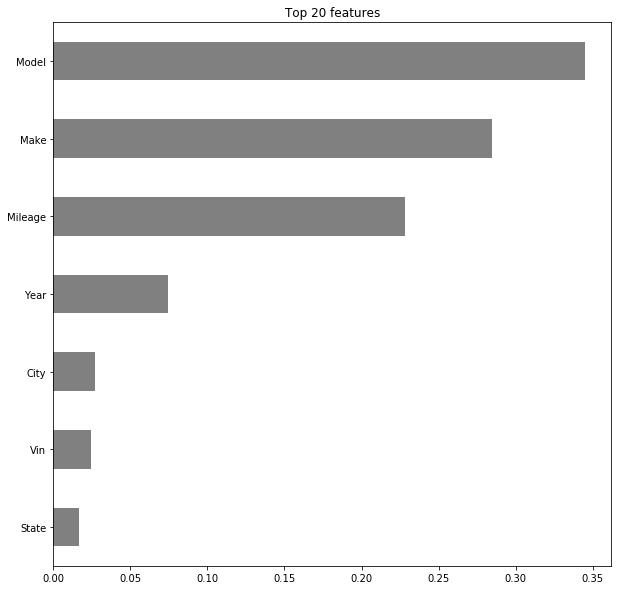

In [57]:
# Get feature importances
rf = pipeline.named_steps['randomforestregressor']
importances = pd.Series(rf.feature_importances_, encoded.columns)

# Plot top n feature importances
n = 20
plt.figure(figsize=(10,n/2))
plt.title(f'Top {n} features')
importances.sort_values()[-n:].plot.barh(color='grey');

In [58]:
# from sklearn.preprocessing import StandardScaler

# scaler = StandardScaler()

# X_train1 = scaler.fit_transform(X_train1)
# X_test1 = scaler.transform(X_test1)
# print(x_train[:10])

In [59]:
encoder = ce.OrdinalEncoder()
X_train1_encoded = encoder.fit_transform(X_train1)

In [60]:
X_train1_encoded

,Year,Mileage,City,State,Vin,Make,Model
81706,2011,89592,1,1,1,1,1
119697,2017,22989,2,2,2,2,2
322252,2013,87542,3,1,3,3,3
24198,2012,2801,4,3,4,4,4
662554,2014,105857,5,4,5,5,5
...,...,...,...,...,...,...,...
221090,2015,37969,333,10,477173,30,10
319653,2014,33746,512,32,477174,3,479
718955,2016,19864,1037,29,477175,10,850
507837,2012,71057,503,6,477176,9,10


In [61]:
# scaler = StandardScaler()
# df2 = pd.DataFrame(scaler.fit_transform(df2), columns = df2.columns)

In [62]:
train2, val2 = train_test_split(df2, train_size=0.70, test_size=0.30)
train2, test2 = train_test_split(train2, train_size= 0.80, test_size=0.20) 

In [63]:
target = 'Price'
features = train2.columns.drop([target])
X_train2 = train2[features]
y_train2 = train2[target]
X_val2 = val2[features]
y_val2 = val2[target]
X_test2 = test2[features]
y_test2 = test2[target]

In [64]:
%%time

# # Important Hyperparameters
# inputs = X_train1_encoded.shape[1]
# epochs = 75
# batch_size = 10


# Create Model
model = Sequential()
model.add(Dense(64, activation='relu', input_dim=7))
model.add(Dense(64, activation='relu'))
model.add(Dense(1))

# # Compile Model
model.compile(optimizer='adam', loss='mse', metrics=['mse', 'mae'])

# model summry

model.summary()
# # Fit Model
model.fit(X_train1_encoded, y_train1, 
#           validation_data=(X_val1,y_val1), 
           epochs=5
#           batch_size=batch_size
          )

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 64)                512       
_________________________________________________________________
dense_1 (Dense)              (None, 64)                4160      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 65        
Total params: 4,737
Trainable params: 4,737
Non-trainable params: 0
_________________________________________________________________
Train on 477188 samples
Epoch 1/5
477188/477188 [==============================] - 16s 34us/sample - loss: 155425248.8715 - mse: 155424976.0000 - mae: 8162.6890
Epoch 2/5
477188/477188 [==============================] - 18s 37us/sample - loss: 144599005.9602 - mse: 144598896.0000 - mae: 7845.0479
Epoch 3/5
477188/477188 [==============================] - 15s 32us/sample - loss: 143

In [65]:
%%time

# # Important Hyperparameters
# inputs = X_train1_encoded.shape[1]
# epochs = 75
# batch_size = 10


# Create Model
model = Sequential()
model.add(Dense(70, activation='relu', input_dim=7))
model.add(Dense(65, activation='relu'))
model.add(Dense(65, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(65, activation='relu'))
model.add(Dense(35, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(25, activation='relu'))
model.add(Dense(10, activation='sigmoid'))
model.add(Dense(1))


# # Compile Model
model.compile(optimizer='nadam', loss='mse', metrics=['mse', 'mae'])

# model summry

model.summary()
# # Fit Model
model.fit(X_train1_encoded, y_train1, 
#           validation_data=(X_val1,y_val1), 
         epochs=9,
         batch_size=10
          )

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 70)                560       
_________________________________________________________________
dense_4 (Dense)              (None, 65)                4615      
_________________________________________________________________
dense_5 (Dense)              (None, 65)                4290      
_________________________________________________________________
dense_6 (Dense)              (None, 64)                4224      
_________________________________________________________________
dense_7 (Dense)              (None, 65)                4225      
_________________________________________________________________
dense_8 (Dense)              (None, 35)                2310      
_________________________________________________________________
dense_9 (Dense)              (None, 50)               

In [67]:
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Dense
 
model = Sequential()
model.add(Dense(1,input_dim=7, activation='sigmoid'))
model.add(Dense(1,activation='sigmoid'))
model.compile(loss='mse', optimizer='adam', metrics=['accuracy'])
model.fit(X_train1_encoded,y_train1, epochs=5)

Train on 477188 samples
Epoch 1/5
477188/477188 [==============================] - 13s 28us/sample - loss: 645701767.0826 - accuracy: 0.0000e+00
Epoch 2/5
477188/477188 [==============================] - 13s 28us/sample - loss: 645699988.1275 - accuracy: 0.0000e+00
Epoch 3/5
477188/477188 [==============================] - 14s 29us/sample - loss: 645699988.9684 - accuracy: 0.0000e+00
Epoch 4/5
477188/477188 [==============================] - 16s 33us/sample - loss: 645699987.9666 - accuracy: 0.0000e+00
Epoch 5/5
477188/477188 [==============================] - 15s 31us/sample - loss: 645699988.4000 - accuracy: 0.0000e+00


Merging Craiglist and Kaggle DataSets

In [73]:
df1 = df1.drop(['cylinders', 'fuel', 'odometer', 'title_status', 'transmission', 'drive', 'size', 'type', 'paint_color', 'lat', 'long', 'condition'], axis=1)

In [74]:
df1

,city,price,year,manufacturer,make,vin,state_code
0,marshall,2800,2004,ford,taurus,1FAFP55UO4G113464,IA
1,reading,4480,2010,honda,insight,JHMZE2H76AS003740,PA
2,chambersburg,4500,2005,chevy,2500 hd,Xxxxxxxxxx,PA
3,rapidcity,38500,2017,chevrolet,silverado,3GCUKREC8HG363009,SD
4,salina,800,2001,ford,escort zx2,3FAFP11371R241940,KS
...,...,...,...,...,...,...,...
142325,saltlakecity,3500,2002,toyota,camry xle,4T1BF30K52U015675,UT
142326,akroncanton,22900,2012,dodge,grand caravan,2C4RDGCG2CR111897,MI
142327,westky,8350,2008,cadillac,dts,1G6KD57Y58U195302,IN
142328,marshall,4788,2009,toyota,camry,4T1BE46K09U401902,IA


In [75]:
# DONT DO THIS LOL
# df1['make'] = df1['Model']
# df1['city'] = df1['City']
# df1['price'] = df1['Price']
# df1['year'] = df1['Year']
# df1['manufacturer'] = df1['Make']
# df1['vin'] = df1['Vin']
# df1['state_code'] = df1['State']

In [76]:
# DO this instead! changing features names to match kaggle before merging!
df1.columns = (['City', 'Price', 'Year', 'Make', 'Model', 'Vin', 'State'])
df1

,City,Price,Year,Make,Model,Vin,State
0,marshall,2800,2004,ford,taurus,1FAFP55UO4G113464,IA
1,reading,4480,2010,honda,insight,JHMZE2H76AS003740,PA
2,chambersburg,4500,2005,chevy,2500 hd,Xxxxxxxxxx,PA
3,rapidcity,38500,2017,chevrolet,silverado,3GCUKREC8HG363009,SD
4,salina,800,2001,ford,escort zx2,3FAFP11371R241940,KS
...,...,...,...,...,...,...,...
142325,saltlakecity,3500,2002,toyota,camry xle,4T1BF30K52U015675,UT
142326,akroncanton,22900,2012,dodge,grand caravan,2C4RDGCG2CR111897,MI
142327,westky,8350,2008,cadillac,dts,1G6KD57Y58U195302,IN
142328,marshall,4788,2009,toyota,camry,4T1BE46K09U401902,IA


In [77]:
# Reordering columns to match kaggle dataset

df1 = df1[['Price', 'Year', 'City', 'State', 'Vin', 'Make', 'Model']]
df1

,Price,Year,City,State,Vin,Make,Model
0,2800,2004,marshall,IA,1FAFP55UO4G113464,ford,taurus
1,4480,2010,reading,PA,JHMZE2H76AS003740,honda,insight
2,4500,2005,chambersburg,PA,Xxxxxxxxxx,chevy,2500 hd
3,38500,2017,rapidcity,SD,3GCUKREC8HG363009,chevrolet,silverado
4,800,2001,salina,KS,3FAFP11371R241940,ford,escort zx2
...,...,...,...,...,...,...,...
142325,3500,2002,saltlakecity,UT,4T1BF30K52U015675,toyota,camry xle
142326,22900,2012,akroncanton,MI,2C4RDGCG2CR111897,dodge,grand caravan
142327,8350,2008,westky,IN,1G6KD57Y58U195302,cadillac,dts
142328,4788,2009,marshall,IA,4T1BE46K09U401902,toyota,camry


In [78]:
# df1.columns = (['Price', 'Year', 'City', 'State', 'Vin', 'Make', 'Model'])

In [79]:
df2 = df2.drop('Mileage', axis=1)
df2

,Price,Year,City,State,Vin,Make,Model
0,8995,2014,El Paso,TX,19VDE2E53EE000083,Acura,ILX6-Speed
1,10888,2013,Long Island City,NY,19VDE1F52DE012636,Acura,ILX5-Speed
2,8995,2013,El Paso,TX,19VDE2E52DE000025,Acura,ILX6-Speed
3,10999,2014,Windsor,CO,19VDE1F71EE003817,Acura,ILX5-Speed
4,14799,2016,Lindon,UT,19UDE2F32GA001284,Acura,ILXAutomatic
...,...,...,...,...,...,...,...
852117,63215,2017,Culver City,CA,YV1A22MK9H1013237,Volvo,S90T6
852118,72260,2017,Englewood,NJ,YV4A22PL3H1186162,Volvo,XC90T6
852119,55999,2016,Fort Collins,CO,YV4A22PL4G1000868,Volvo,XC90AWD
852120,60240,2017,San Leandro,CA,YV4A22NLXH1006162,Volvo,V90


In [80]:
df = df1.append(df2)
df

,Price,Year,City,State,Vin,Make,Model
0,2800,2004,marshall,IA,1FAFP55UO4G113464,ford,taurus
1,4480,2010,reading,PA,JHMZE2H76AS003740,honda,insight
2,4500,2005,chambersburg,PA,Xxxxxxxxxx,chevy,2500 hd
3,38500,2017,rapidcity,SD,3GCUKREC8HG363009,chevrolet,silverado
4,800,2001,salina,KS,3FAFP11371R241940,ford,escort zx2
...,...,...,...,...,...,...,...
852117,63215,2017,Culver City,CA,YV1A22MK9H1013237,Volvo,S90T6
852118,72260,2017,Englewood,NJ,YV4A22PL3H1186162,Volvo,XC90T6
852119,55999,2016,Fort Collins,CO,YV4A22PL4G1000868,Volvo,XC90AWD
852120,60240,2017,San Leandro,CA,YV4A22NLXH1006162,Volvo,V90


In [81]:
df.isnull().sum()

Price    0
Year     0
City     0
State    0
Vin      0
Make     0
Model    0
dtype: int64

In [82]:
df.describe(include='all')

,Price,Year,City,State,Vin,Make,Model
count,9.944520e+05,994452.000000,994452,994452,994452,994452,994452
unique,NaN,NaN,2987,109,938206,107,16041
top,NaN,NaN,Houston,TX,0,Ford,Silverado
freq,NaN,NaN,12703,94654,785,110432,24932
mean,2.505743e+04,2012.459303,NaN,NaN,NaN,NaN,NaN
std,2.249342e+06,5.035637,NaN,NaN,NaN,NaN,NaN
min,1.000000e+00,1900.000000,NaN,NaN,NaN,NaN,NaN
25%,1.198800e+04,2011.000000,NaN,NaN,NaN,NaN,NaN
50%,1.750000e+04,2014.000000,NaN,NaN,NaN,NaN,NaN
75%,2.599100e+04,2015.000000,NaN,NaN,NaN,NaN,NaN


In [83]:
# df.to_csv('cart_smart', index=False)

## JOBLIB CELL TO UNCOMMENT TO SAVE MODEL,, this joblib is for pipeline1 from Kaggle data!

In [84]:
# from joblib import dump
# dump(pipeline1, 'pipeline1.joblib', compress=True)

In [85]:
train, val = train_test_split(df, train_size=0.70, test_size=0.30)
train, test = train_test_split(train, train_size= 0.80, test_size=0.20) 

In [86]:
target = 'Price'
features = train.columns.drop([target])
X_train = train[features]
y_train = train[target]
X_val = val[features]
y_val = val[target]
X_test = test[features]
y_test = test[target]

In [87]:
%%time

pipeline1 = make_pipeline(
    ce.OrdinalEncoder(),
    SimpleImputer(strategy='mean'),
    RandomForestRegressor(n_estimators=170, n_jobs=-1)
)

# Fit on train, score on val

pipeline.fit(X_train, y_train)
print('Train Accuracy', pipeline.score(X_train, y_train))
print('Validation Accuracy', pipeline.score(X_val, y_val))    

Train Accuracy 0.0004024847551353794
Validation Accuracy -0.00019496217501679958
CPU times: user 18min 41s, sys: 18.6 s, total: 18min 59s
Wall time: 2min 50s


In [88]:
%%time

pipeline2 = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='mean'), 
    GradientBoostingRegressor()
)

# Fit on train, score on val

pipeline.fit(X_train, y_train)
print('Train Accuracy', pipeline.score(X_train, y_train))
print('Validation Accuracy', pipeline.score(X_val, y_val))  

Train Accuracy 0.0004058288390135223
Validation Accuracy -0.0001760037175646545
CPU times: user 18min 43s, sys: 21.5 s, total: 19min 5s
Wall time: 2min 53s


In [89]:
%%time

pipeline3 = make_pipeline(
    ce.OrdinalEncoder(), 
    XGBRegressor(n_estimators=1700, 
    maxdepth=8, n_jobs=-1,
    learning_rate=0.5)
)

# Fit on train, score on val

pipeline.fit(X_train, y_train)
print('Train Accuracy', pipeline.score(X_train, y_train))
print('Validation Accuracy', pipeline.score(X_val, y_val))

NameError: name 'XGBRegressor' is not defined

In [90]:
!pip install xgboost

  Using cached https://files.pythonhosted.org/packages/36/a5/703d93321f57048596217789be7c186304a33aff5b1c48c89597a546c65e/xgboost-1.0.2.tar.gz
    ERROR: Command errored out with exit status 1:
     command: /Users/Medy/opt/anaconda3/bin/python -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/private/var/folders/__/m8067101339gyqhwnk6r4rx00000gn/T/pip-install-2iu_trv5/xgboost/setup.py'"'"'; __file__='"'"'/private/var/folders/__/m8067101339gyqhwnk6r4rx00000gn/T/pip-install-2iu_trv5/xgboost/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' egg_info --egg-base pip-egg-info
         cwd: /private/var/folders/__/m8067101339gyqhwnk6r4rx00000gn/T/pip-install-2iu_trv5/xgboost/
    Complete output (27 lines):
    ++ pwd
    + oldpath=/private/var/folders/__/m8067101339gyqhwnk6r4rx00000gn/T/pip-install-2iu_trv5/xgboost
    + cd ./xgboost/
    + mkdir -p build
    